# Validation of Data

@roman

13 June, 2024

---
# Settings

In [3]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import uuid

from INEGIpy import MarcoGeoestadistico

In [4]:
# Settings
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)
geo_framework = MarcoGeoestadistico()

---
# Data

In [5]:
# read parquet
df_properties = pd.read_parquet("../../data/raw/appraisals.parquet")
df_properties.head()

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,latitude,longitude,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,<NA>,<NA>,<NA>,<NA>,36,1,2022-06-14,NaN,100.0,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,7,1,NaN,1,2,78,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,16.737283,-92.672659,3,3,S/D,3,10.750000,216.809998,227.559998,302.700012,NaN,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1033417.8,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1
1,1,2,4,MAYA,NO APLICA,97134,<NA>,<NA>,<NA>,<NA>,204,1,2022-11-15,NaN,100.0,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,50,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,21.014297,-89.575189,3,2,S/D,3,13.380000,141.550003,154.929993,198.000000,NaN,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.0,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52
2,0,1,3,KANASIN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,60,1,2022-06-22,NaN,100.0,NaN,NaN,NaN,NaN,3,5,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,41,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,a7f6ef17-0933-4138-9aa9-99529929184d,20.928954,-89.546637,3,1,S/D,2,1.120000,44.349998,45.470001,144.800003,NaN,1.0,NaN,<NA>,446378.0,450000.0,279611.30,102663.2,<NA>,55,e57ad294-8db8-4ca1-b01f-7ccbc5981922,552216f4-540b-500d-a4e7-6be55b2b6703
3,0,1,3,MULCHECHEN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,192,1,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,41,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,20.916897,-89.580945,3,1,S/D,2,2.160000,52.049999,54.209999,133.750000,NaN,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.0,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54
4,0,3,4,POBLACION MOTUL,NO APLICA,97430,<NA>,<NA>,<NA>,<NA>,116,0,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,52,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,21.096391,-89.285366,3,2,S/D,2,19.049999,229.929993,248.979996,844.520020,NaN,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,641835.2,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41


In [6]:
# see columns
df_properties.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2339244 entries, 0 to 2339243
Data columns (total 60 columns):
 #   Column                                     Dtype         
---  ------                                     -----         
 0   half_bathrooms                             uint8         
 1   full_bathrooms                             uint8         
 2   property_class_more_common_in_area         string        
 3   neighborhood                               string        
 4   constructor                                string        
 5   zip_code                                   uint32        
 6   property_account_id                        string        
 7   special_common_installations_description   string        
 8   special_private_installations_description  string        
 9   complementary_common_works_description     string        
 10  age_in_months                              uint8         
 11  parking_lots                               uint8         
 12  

---
# Geospatial Validation

## S1: Points Inside Mexico

### Get Data

In [8]:
# geodataframe
gdf_properties = (
    gpd.GeoDataFrame(
        df_properties,
        geometry=gpd.points_from_xy(df_properties['longitude'], df_properties['latitude']),
        crs='EPSG:4326'
    )
    .drop(columns=['latitude', 'longitude'])
    .assign(
        state_id=lambda x: x['state_id'].astype(str).str.zfill(2),
        municipality_id=lambda x: x['municipality_id'].astype(str).str.zfill(3)
    )
)

gdf_properties.head()

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,<NA>,<NA>,<NA>,<NA>,36,1,2022-06-14,NaN,100.0,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,07,1,NaN,1,2,078,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,3,3,S/D,3,10.750000,216.809998,227.559998,302.700012,NaN,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1033417.8,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (-92.67266 16.73728)
1,1,2,4,MAYA,NO APLICA,97134,<NA>,<NA>,<NA>,<NA>,204,1,2022-11-15,NaN,100.0,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,3,2,S/D,3,13.380000,141.550003,154.929993,198.000000,NaN,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.0,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430)
2,0,1,3,KANASIN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,60,1,2022-06-22,NaN,100.0,NaN,NaN,NaN,NaN,3,5,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,a7f6ef17-0933-4138-9aa9-99529929184d,3,1,S/D,2,1.120000,44.349998,45.470001,144.800003,NaN,1.0,NaN,<NA>,446378.0,450000.0,279611.30,102663.2,<NA>,55,e57ad294-8db8-4ca1-b01f-7ccbc5981922,552216f4-540b-500d-a4e7-6be55b2b6703,POINT (-89.54664 20.92895)
3,0,1,3,MULCHECHEN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,192,1,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,3,1,S/D,2,2.160000,52.049999,54.209999,133.750000,NaN,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.0,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690)
4,0,3,4,POBLACION MOTUL,NO APLICA,97430,<NA>,<NA>,<NA>,<NA>,116,0,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,052,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,3,2,S/D,2,19.049999,229.929993,248.979996,844.520020,NaN,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,641835.2,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (-89.28537 21.09639)


In [9]:
# get all mexico states
gdf_mex_states = geo_framework.Entidades()
gdf_mex_states.head()

,geometry,cvegeo,cve_agee,nom_agee,nom_abrev,pob,pob_fem,pob_mas,viv
0,"MULTIPOLYGON (((-102.29739 22.45527, -102.2955...",01,01,Aguascalientes,Ags.,1425607,728924,696683,386671
1,"MULTIPOLYGON (((-114.11561 28.09639, -114.1152...",02,02,Baja California,BC,3769020,1868431,1900589,1149563
2,"MULTIPOLYGON (((-109.89451 22.87476, -109.8946...",03,03,Baja California Sur,BCS,798447,392568,405879,240660
3,"MULTIPOLYGON (((-91.95650 20.19700, -91.95636 ...",04,04,Campeche,Camp.,928363,471424,456939,260824
4,"MULTIPOLYGON (((-102.31549 29.88000, -102.3150...",05,05,Coahuila de Zaragoza,Coah.,3146771,1583102,1563669,901249


<Axes: >

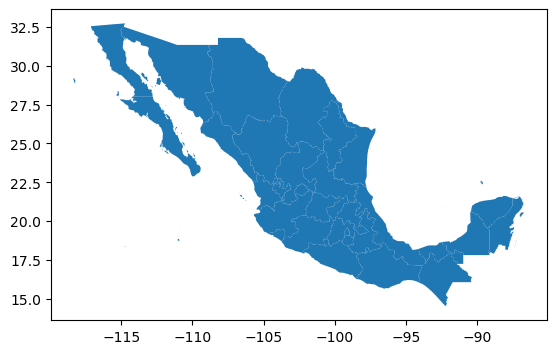

In [10]:
# plot states
gdf_mex_states.plot()

### Spatial Join

In [11]:
# join properties with states, if the point is inside any state
gdf_properties_country_not_match = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='left')
    # get only the properties that did not match
    .loc[lambda x: x['cvegeo'].isna()]
    )

gdf_properties_country_not_match.shape

(60, 68)

<Axes: >

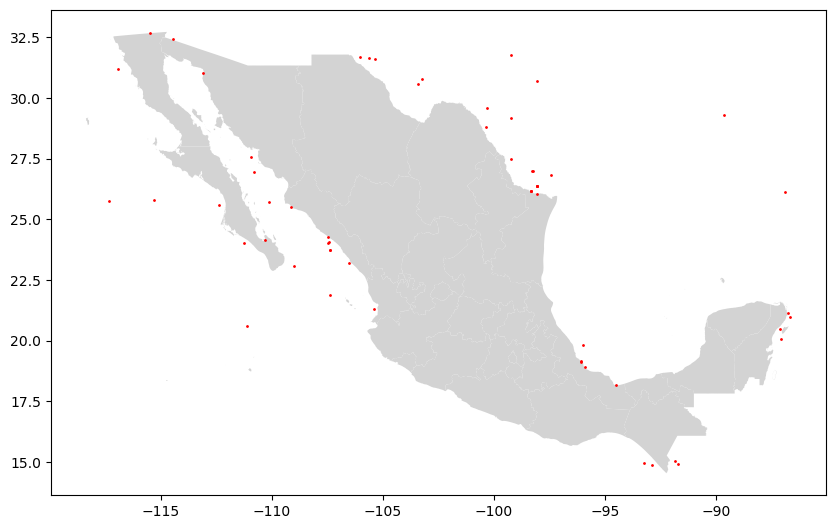

In [15]:
# plot properties that did not match
fig, ax = plt.subplots(figsize=(10, 10))
gdf_mex_states.plot(ax=ax, color='lightgrey')
gdf_properties_country_not_match.plot(ax=ax, color='red', markersize=1)

In [24]:
# explore the properties that did not match
gdf_properties_country_not_match.loc[:, ['state_id', 'municipality_id', 'geometry']].explore(tiles='cartodbpositron')

In [25]:
# clean the properties that did not match
gdf_properties = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='inner')
    .drop(columns=['index_right'])
    .loc[:, gdf_properties.columns]
)


In [26]:
# shape
gdf_properties.shape

(2339184, 59)

In [27]:
# cols
gdf_properties.head()

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,<NA>,<NA>,<NA>,<NA>,36,1,2022-06-14,NaN,100.0,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,07,1,NaN,1,2,078,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,3,3,S/D,3,10.750000,216.809998,227.559998,302.700012,NaN,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1033417.8,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (-92.67266 16.73728)
1,1,2,4,MAYA,NO APLICA,97134,<NA>,<NA>,<NA>,<NA>,204,1,2022-11-15,NaN,100.0,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,3,2,S/D,3,13.380000,141.550003,154.929993,198.000000,NaN,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,984852.0,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430)
2,0,1,3,KANASIN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,60,1,2022-06-22,NaN,100.0,NaN,NaN,NaN,NaN,3,5,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,a7f6ef17-0933-4138-9aa9-99529929184d,3,1,S/D,2,1.120000,44.349998,45.470001,144.800003,NaN,1.0,NaN,<NA>,446378.0,450000.0,279611.30,102663.2,<NA>,55,e57ad294-8db8-4ca1-b01f-7ccbc5981922,552216f4-540b-500d-a4e7-6be55b2b6703,POINT (-89.54664 20.92895)
3,0,1,3,MULCHECHEN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,192,1,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,3,1,S/D,2,2.160000,52.049999,54.209999,133.750000,NaN,1.0,NaN,<NA>,424468.0,424000.0,290492.55,96835.0,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690)
4,0,3,4,POBLACION MOTUL,NO APLICA,97430,<NA>,<NA>,<NA>,<NA>,116,0,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,052,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,3,2,S/D,2,19.049999,229.929993,248.979996,844.520020,NaN,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,641835.2,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (-89.28537 21.09639)


## S2: Points inside each state 

In [28]:
# join properties with states, if the point is inside any state
gdf_properties_states_not_match = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='inner')
    .assign(state_id=lambda x: x['state_id'].astype(str).str.zfill(2))
    .query("state_id != cvegeo")
    )

gdf_properties_states_not_match.shape

(469, 68)

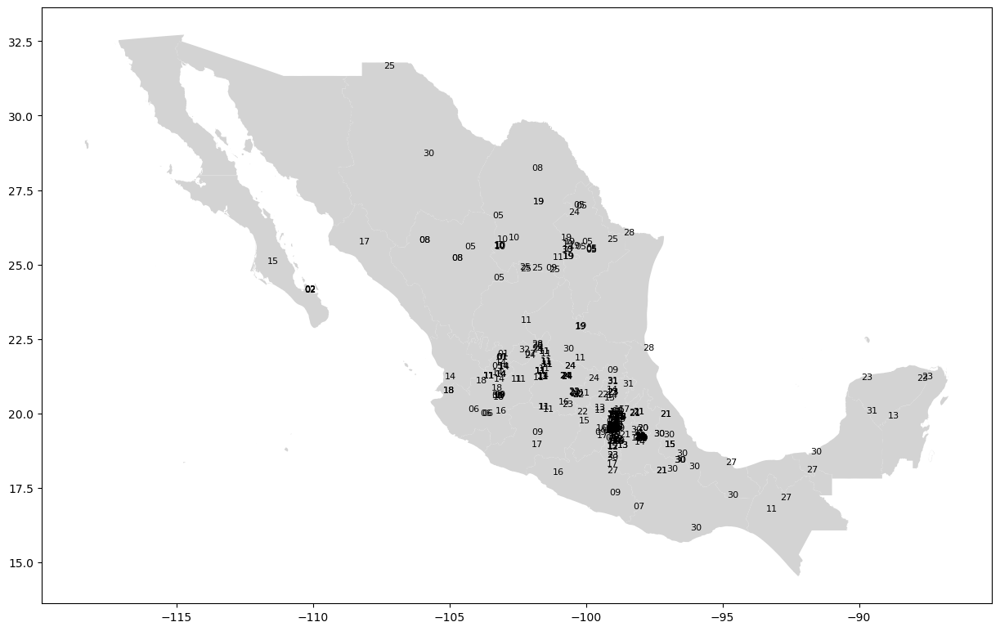

In [29]:
# plot properties that did not match
fig, ax = plt.subplots(figsize=(15, 15))
gdf_mex_states.plot(ax=ax, color='lightgrey')
# gdf_properties_states_not_match.plot(ax=ax, color='red', markersize=1)
# marker as the state name
for idx, row in gdf_properties_states_not_match.iterrows():
    ax.text(row.geometry.x, row.geometry.y, row['state_id'], fontsize=8)

In [30]:
# clean the properties that did not match
gdf_properties = (
    gpd.sjoin(gdf_properties, gdf_mex_states, predicate='within', how='inner')
    .query("state_id == cvegeo")
    .drop(columns=['index_right'])
    .loc[:, gdf_properties.columns]
)
gdf_properties.shape

(2338715, 59)

In [31]:
gdf_properties

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
0,1,2,4,VISTA HERMOSA HUITEPEC,NO APLICA,29263,<NA>,<NA>,<NA>,<NA>,36,1,2022-06-14,NaN,100.0,NaN,NaN,NaN,NaN,4,4,301ef216-0137-4989-bdd0-32bf1adf1e9b,0.0,07,1,NaN,1,2,078,6f8c15c7-2914-40bb-87ff-59076af288c9,3,NaN,NaN,NaN,2,NaN,35a7806a-f686-4159-be91-16997e86d271,87aa63b6-9005-4ed3-ba44-fcd75453a9e9,3,3,S/D,3,10.750000,216.809998,227.559998,302.700012,NaN,1.0,NaN,<NA>,3716737.0,3717000.0,2532281.13,1.033418e+06,<NA>,67,02086af7-ffbb-4e67-b857-27e6cef09b0d,2b225ce9-7742-512e-aac5-846811f1a6a1,POINT (-92.67266 16.73728)
1,1,2,4,MAYA,NO APLICA,97134,<NA>,<NA>,<NA>,<NA>,204,1,2022-11-15,NaN,100.0,NaN,NaN,NaN,NaN,4,4,717559f7-a918-48f7-9356-c79c582d95b3,0.0,31,2,NaN,1,2,050,9a2781c9-b312-453c-86d1-a6e90584a083,2,NaN,NaN,NaN,2,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,02af4710-0922-4bed-9763-045ba14e0283,3,2,S/D,3,13.380000,141.550003,154.929993,198.000000,NaN,1.0,NaN,<NA>,2348706.0,2349000.0,1111845.21,9.848520e+05,<NA>,53,43c375b2-75fd-4fcc-b311-55b396e7cbbf,b7f8c282-b67e-5d63-920d-c603b4e2eb52,POINT (-89.57519 21.01430)
2,0,1,3,KANASIN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,60,1,2022-06-22,NaN,100.0,NaN,NaN,NaN,NaN,3,5,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,a7f6ef17-0933-4138-9aa9-99529929184d,3,1,S/D,2,1.120000,44.349998,45.470001,144.800003,NaN,1.0,NaN,<NA>,446378.0,450000.0,279611.30,1.026632e+05,<NA>,55,e57ad294-8db8-4ca1-b01f-7ccbc5981922,552216f4-540b-500d-a4e7-6be55b2b6703,POINT (-89.54664 20.92895)
3,0,1,3,MULCHECHEN,NO APLICA,97370,<NA>,<NA>,<NA>,<NA>,192,1,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,3,4,8378ef1c-2fdf-4b2a-be29-0e62eb19d753,2.0,31,2,NaN,1,3,041,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,2,NaN,4e63856b-ae68-4653-bcaa-86a51d5d7053,923b9bb1-9ab4-4984-93f1-c873b3c26977,3,1,S/D,2,2.160000,52.049999,54.209999,133.750000,NaN,1.0,NaN,<NA>,424468.0,424000.0,290492.55,9.683500e+04,<NA>,44,f95c14fe-9acc-4b5c-872b-bd15d412a65d,7215360d-9d5e-538a-971f-15fbef435f54,POINT (-89.58095 20.91690)
4,0,3,4,POBLACION MOTUL,NO APLICA,97430,<NA>,<NA>,<NA>,<NA>,116,0,2022-11-01,NaN,100.0,NaN,NaN,NaN,NaN,4,4,1f637d21-f0cb-43be-b989-5923e4c01d94,0.0,31,1,NaN,1,2,052,bc0e00ba-8c35-465f-bbcd-61cedf83d6d8,1,NaN,NaN,NaN,2,NaN,90a0a9f7-fab3-4170-b3da-db49e122e41b,f6e764a4-141c-4b02-b902-4a158ec58c58,3,2,S/D,2,19.049999,229.929993,248.979996,844.520020,NaN,1.0,NaN,<NA>,2779000.0,2779000.0,1767043.79,6.418352e+05,<NA>,39,74af41d9-b7b3-464d-9302-7fd1f231ee26,5b18adfe-606c-590f-bc76-d3eabfd0ba41,POINT (-89.28537 21.09639)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2339239,1,3,5,FRACC RES CAMPESTRE CONDADO SAYAVEDRA,NO APLICA,52938,<NA>,3,<NA>,3,0,4

## S3: Points inside each municipality

### Raw

#### Query Info

In [32]:
# params
ID_ENTIDAD = '09'

In [33]:
# get municipalities of the state
gdf_mun = geo_framework.Municipios(ID_ENTIDAD)
gdf_mun.shape

(16, 10)

<Axes: >

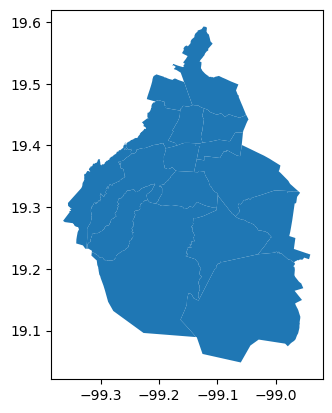

In [34]:
# plot
gdf_mun.plot()

#### Join

In [35]:
# join
gdf_properties_mun_not_match = (
    gdf_properties
    .query("state_id == @ID_ENTIDAD")
    .sjoin(gdf_mun, how='left', predicate='within')
    .query("municipality_id != cve_agem")
)
gdf_properties_mun_not_match.shape

(206, 69)

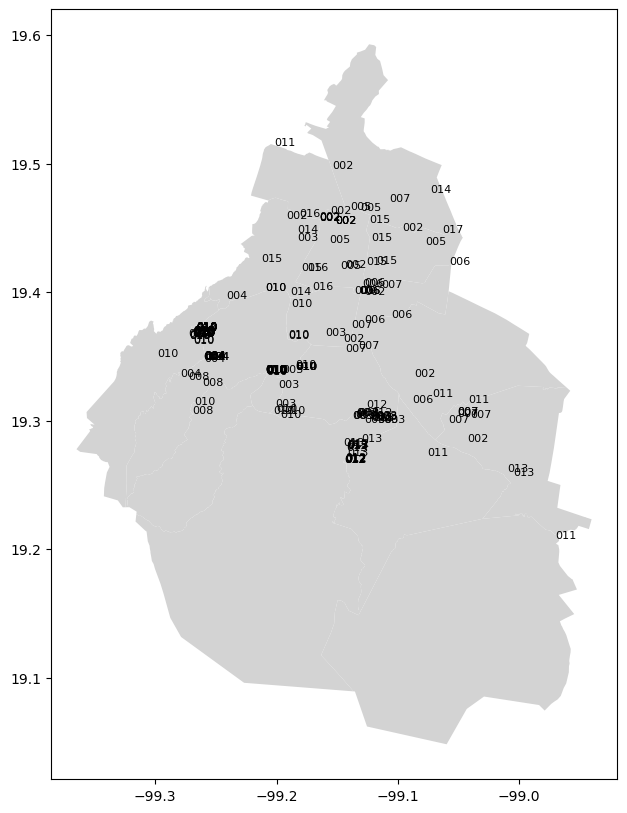

In [36]:
# plot
fig, ax = plt.subplots(figsize=(10, 10))
gdf_mun.plot(ax=ax, color='lightgrey')
# marker as the municipality name
for idx, row in gdf_properties_mun_not_match.iterrows():
    ax.text(row.geometry.x, row.geometry.y, row['municipality_id'], fontsize=8)

### Programatically clean the data

In [37]:
def process_id_entidad(id_entidad, gdf_properties):
    """
    Process the GeoDataFrame for a given id_entidad and save the result.

    Parameters:
    - id_entidad (str): The id_entidad to process.
    - gdf_properties (GeoDataFrame): The GeoDataFrame of properties.
    """
    # Get municipalities of the state
    gdf_mun = geo_framework.Municipios(id_entidad)

    # Filter and join GeoDataFrames
    gdf_result = (
        gdf_properties
        .query("state_id == @id_entidad")
        .sjoin(gdf_mun, how='left', predicate='within')
        .query("municipality_id != cve_agem")
    )

    return gdf_result

# process
entity_list = gdf_properties['state_id'].unique()
wrong_mun_gdf = []

for entity in tqdm(entity_list):
    wrong_mun_gdf.append(process_id_entidad(entity, gdf_properties))


100%|██████████| 32/32 [05:54<00:00, 11.09s/it]


In [38]:
# concat
gdf_properties_wrong_mun = pd.concat(wrong_mun_gdf)
gdf_properties_wrong_mun.shape

(28096, 70)

<Axes: >

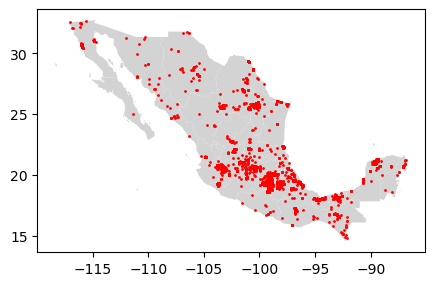

In [39]:
# plot
fig, ax = plt.subplots(figsize=(5, 5))
gdf_mex_states.plot(ax=ax, color='lightgrey')
gdf_properties_wrong_mun.plot(ax=ax, color='red', markersize=1)

## S4: Generic Coords

In [41]:
# look repeated geocoords
gdf_repeated_geocoords = (
    gdf_properties
    .groupby(['geometry'])
    .size()
    .reset_index(name='count')
    .query("count > 1")
    .sort_values('count', ascending=False)
)
gdf_repeated_geocoords

,geometry,count
1920594,POINT (-98.16662 18.97263),591
1599476,POINT (-99.12531 19.63467),300
1093430,POINT (-87.10958 20.66428),189
987106,POINT (-98.39328 26.01327),159
1919700,POINT (-98.22643 18.96510),142
...,...,...
773983,POINT (-100.30959 25.87262),2
773992,POINT (-100.31009 25.87251),2
774038,POINT (-100.30774 25.86805),2
774044,POINT (-100.30827 25.86784),2


In [42]:
# describe count
gdf_repeated_geocoords['count'].describe()

count    177826.000000
mean          2.676178
std           3.062053
min           2.000000
25%           2.000000
50%           2.000000
75%           2.000000
max         591.000000
Name: count, dtype: float64

In [43]:
# see cum dist
gdf_repeated_geocoords['count'].value_counts(normalize=True).to_frame().round(4).head(20).T

count,2,3,4,6,5,8,7,9,10,16,12,11,17,14,13,15,18,19,20,21
proportion,0.7661,0.1181,0.0444,0.0241,0.0154,0.0092,0.0064,0.0025,0.0023,0.0019,0.0016,0.0014,0.0008,0.0007,0.0007,0.0007,0.0005,0.0004,0.0003,0.0002


In [44]:
# see cum dist
gdf_repeated_geocoords['count'].value_counts(normalize=True).cumsum().to_frame().round(4).head(20).T

count,2,3,4,6,5,8,7,9,10,16,12,11,17,14,13,15,18,19,20,21
proportion,0.7661,0.8843,0.9286,0.9527,0.9681,0.9774,0.9838,0.9863,0.9886,0.9905,0.9921,0.9936,0.9943,0.9951,0.9958,0.9964,0.9969,0.9973,0.9976,0.9978


In [45]:
# see how many are above 1, 2, 15 and 50
(
    gdf_properties
    .groupby(['geometry'])
    .size()
    .reset_index(name='count')
    .agg(
        properties_above_1=('count', lambda x: x[x > 1].sum()),
        properties_above_2=('count', lambda x: x[x > 2].sum()),
        properties_above_8=('count', lambda x: x[x > 8].sum()),
        properties_above_15=('count', lambda x: x[x > 15].sum()),
        points_above_1=('count', lambda x: (x > 1).sum()),
        points_above_2=('count', lambda x: (x > 2).sum()),
        points_above_8=('count', lambda x: (x > 8).sum()),
        points_above_15=('count', lambda x: (x > 15).sum())
    )
    .assign(
        perc=lambda x: x / gdf_properties.shape[0]
    )
)

,count,perc
properties_above_1,475894,0.203485
properties_above_2,203420,0.086979
properties_above_8,48299,0.020652
properties_above_15,28642,0.012247
points_above_1,177826,0.076036
points_above_2,41589,0.017783
points_above_8,2884,0.001233
points_above_15,1106,0.000473


In [46]:
# see properties with the coord most repeated
coord_most_repeated = (
    gdf_properties
    .groupby(['geometry'])
    .size()
    .reset_index(name='count')
    .sort_values('count', ascending=False)
    .head(1)
    .geometry
    .values[0]
)

gdf_most_repeated_point = (
    gdf_properties
    .sjoin(gpd.GeoDataFrame({'geometry': [coord_most_repeated]}), how='inner', predicate='intersects')
    .drop(columns=['index_right'])
)

gdf_most_repeated_point

/Users/ravj/opt/anaconda3/envs/mds-research-stay/lib/python3.10/site-packages/geopandas/geodataframe.py:2178: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  return geopandas.sjoin(left_df=self, right_df=df, *args, **kwargs)


,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry
11743,0,1,3,SAN FRANCISCO TOTIMEHUACAN,IVI CONSTRUCTORA,72595,<NA>,<NA>,<NA>,<NA>,0,1,2022-05-30,NaN,100.0,NaN,NaN,NaN,NaN,3,6,4ff49046-7b84-45bd-bfd7-88cb7b0c93fb,2.0,21,4,NaN,3,6,114,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,4,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,701b0ff3-aa18-42b8-9ab1-9c2e63ddd568,3,1,S/D,2,7.33,48.509998,48.509998,21.000000,NaN,1.0,NaN,<NA>,432709.0,433000.0,342286.56,32333.9100,<NA>,60,7b58d5ea-5e8c-4733-98ad-a6583cfb8842,e53135c9-dcf8-5cd2-9b66-689e536ab6c3,POINT (-98.16662 18.97263)
11748,0,1,3,SAN FRANCISCO TOTIMEHUACAN,IVI CONSTRUCTORA,72595,<NA>,<NA>,<NA>,<NA>,0,1,2022-05-30,NaN,100.0,NaN,NaN,NaN,NaN,3,6,4ff49046-7b84-45bd-bfd7-88cb7b0c93fb,2.0,21,4,NaN,3,6,114,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,4,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,701b0ff3-aa18-42b8-9ab1-9c2e63ddd568,3,1,S/D,2,7.33,48.509998,48.509998,21.000000,NaN,1.0,NaN,<NA>,432709.0,433000.0,342286.56,32333.9100,<NA>,60,b8586947-9323-4fe5-93b5-d7d0b7f65221,e53135c9-dcf8-5cd2-9b66-689e536ab6c3,POINT (-98.16662 18.97263)
11750,0,1,3,SAN FRANCISCO TOTIMEHUACAN,IVI CONSTRUCTORA,72595,<NA>,<NA>,<NA>,<NA>,0,1,2022-05-30,NaN,100.0,NaN,NaN,NaN,NaN,3,6,4ff49046-7b84-45bd-bfd7-88cb7b0c93fb,2.0,21,4,NaN,3,6,114,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,4,NaN,b3bf58b2-40cc-4edd-bcf1-e4a0b2798533,701b0ff3-aa18-42b8-9ab1-9c2e63ddd568,3,1,S/D,2,7.33,48.509998,48.509998,21.000000,NaN,1.0,NaN,<NA>,454053.0,454000.0,342286.56,32333.9100,<NA>,60,f723492c-42a0-4917-95ec-b3b4236c8c2b,e53135c9-dcf8-5cd2-9b66-689e536ab6c3,POINT (-98.16662 18.97263)
20239,0,1,3,SAN FRANCISCO TOTIMEHUACAN,IVI CONSTRUCTORA,72595,<NA>,<NA>,<NA>,<NA>,0,1,2022-11-29,NaN,100.0,NaN,NaN,NaN,NaN,3,6,57a9776e-72ec-48cd-88d1-e029ca16a48b,2.0,21,4,NaN,3,6,114,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,4,NaN,d2649461-041b-4890-9bb2-329b90256ae5,78e82f90-b946-4a03-80b9-9e5db2329afa,3,1,S/D,2,7.33,48.509998,48.509998,23.900000,NaN,1.0,NaN,<NA>,519802.0,519800.0,366250.50,38247.8870,<NA>,60,dfc85bb6-64ff-452b-9902-53f379e9ffbe,77b3182c-edd9-5b1b-93dc-bf96f7c4fd3b,POINT (-98.16662 18.97263)
40629,0,2,3,SAN FRANCISCO TOTIMEHUACAN,IVI CONSTRUCTORA,72595,<NA>,<NA>,<NA>,<NA>,0,1,2022-06-08,NaN,100.0,NaN,NaN,NaN,NaN,3,6,57a9776e-72ec-48cd-88d1-e029ca16a48b,2.0,21,4,NaN,3,6,114,98013144-6a9f-4e08-9255-cb54568d2f5a,2,NaN,NaN,NaN,3,NaN,d2649461-041b-4890-9bb2-329b90256ae5,cff4983b-2860-41b0-aa65-2a0f5b6e76b7,3,2,S/D,2,0.49,74.309998,74.309998,61.360001,NaN,1.0,NaN,<NA>,714862.0,715000.0,568397.19,129403.3312,<NA>,60,1b9d2202-3a7b-4a5d-90d7-889381777ea4,a29bc9bb-41ba-58c6-8c3b-e034ad60f459,POINT (-98.16662 18.97263)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1336416,0,2,3,SAN 

<Axes: >

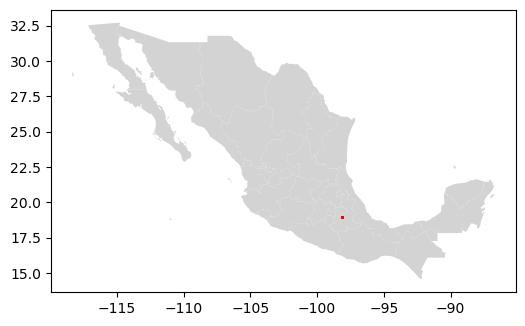

In [47]:
# plot
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mex_states.plot(ax=ax, color='lightgrey')
gdf_most_repeated_point.plot(ax=ax, color='red', markersize=0.1)


---
# Repeated IDs

## Get Data

In [48]:
# unique id's
gdf_properties['property_id'].nunique()

2092858

In [49]:
# get properties with repeated property_id
gdf_repeated_property_id = (
    gdf_properties
    .assign(
        num_property_id=lambda x: x.groupby('property_id')['property_id'].transform('count')
    )
    .query("num_property_id > 1")
    .sort_values(['property_id', 'valuation_date'])
)
gdf_repeated_property_id

,half_bathrooms,full_bathrooms,property_class_more_common_in_area,neighborhood,constructor,zip_code,property_account_id,special_common_installations_description,special_private_installations_description,complementary_common_works_description,age_in_months,parking_lots,valuation_date,common_areas_completion_percentage,private_works_completion_percentage,potable_water_service_id,lighting_service_id,sidewalk_id,project_quality_id,property_class_id,conservation_status_id,controller_id,elevator_service_id,state_id,equipment_id,curb_id,infrastructure_service_id,road_materials_id,municipality_id,grantor_id,urban_proximity_id,water_collection_service_id,electrical_supply_service_id,telephone_service_supply_id,property_type_id,public_transportation_service_id,valuation_unit_id,valuation_professional_id,level,total_levels,purpose_of_appraisal,bedrooms,accessory_area,built_area,saleable_area,land_area,distance_to_public_transportation,rentable_units,rentable_units_subject_property,current_use,market_price,price,built_price,land_price,access_routes,remaining_useful_life,observation_id,property_id,geometry,num_property_id
1432158,0,1,3,TIXCACAL,SADASI,97312,<NA>,<NA>,<NA>,<NA>,0,1,2020-08-12,NaN,NaN,NaN,NaN,NaN,NaN,3,6,b1443922-960e-485e-acf7-e6c1b2a25c6c,2.0,31,2,NaN,3,6,050,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,4,NaN,73c93293-e9b5-4953-aae4-7a18a74a651c,74bc5110-b09e-43da-8ce6-d44224453354,3,1,S/D,2,12.15,59.259998,71.410004,117.019997,NaN,NaN,NaN,<NA>,516257.0,516000.0,396914.46,106652.0280,<NA>,60,2e28a417-020f-4f39-9562-c6b3315bd137,0000291c-98bd-53f9-aecb-a94c68d590da,POINT (-89.70680 20.93528),3
1636157,0,1,3,TIXCACAL,SADASI,97312,<NA>,<NA>,<NA>,<NA>,0,1,2020-08-18,NaN,NaN,1.0,3.0,1.0,1.0,3,6,b1443922-960e-485e-acf7-e6c1b2a25c6c,2.0,31,2,1.0,3,3,050,98013144-6a9f-4e08-9255-cb54568d2f5a,3,1.0,2.0,2.0,4,1.0,73c93293-e9b5-4953-aae4-7a18a74a651c,74bc5110-b09e-43da-8ce6-d44224453354,3,1,S/D,2,12.15,59.259998,71.410004,117.019997,NaN,4.0,1.0,DEPARTAMENTO EN CONDOMINIO,516257.0,516000.0,396914.46,106652.0280,A TRAVES DEL ANILLO PERIFERICO PONIENTE AV. 51...,60,89f84a28-b861-4af2-a4ab-3f192dd0a8ca,0000291c-98bd-53f9-aecb-a94c68d590da,POINT (-89.70680 20.93528),3
1151739,0,1,3,TIXCACAL,SADASI,97312,<NA>,<NA>,<NA>,<NA>,0,1,2021-10-29,NaN,NaN,1.0,3.0,1.0,1.0,3,6,b1443922-960e-485e-acf7-e6c1b2a25c6c,2.0,31,2,1.0,3,3,050,98013144-6a9f-4e08-9255-cb54568d2f5a,3,1.0,2.0,2.0,4,1.0,73c93293-e9b5-4953-aae4-7a18a74a651c,74bc5110-b09e-43da-8ce6-d44224453354,4,1,S/D,2,2.44,59.259998,61.700001,20.980000,NaN,4.0,1.0,DEPARTAMENTO EN CONDOMINIO,481277.0,481000.0,367459.26,19511.8196,A TRAVES DEL ANILLO PERIFERICO PONIENTE AV. 51...,60,aa98ccb1-dad0-41a1-9243-f220819887f7,0000291c-98bd-53f9-aecb-a94c68d590da,POINT (-89.70680 20.93528),3
1407464,0,1,3,FRACCIONAMIENTO ALTURAS DEL SUR ETAPA XIV CATORCE,URBANIZADORA LEY DEL PACIFICO,80295,<NA>,<NA>,<NA>,<NA>,0,1,2020-09-04,NaN,NaN,NaN,NaN,NaN,NaN,3,6,5c37c2ac-b6a4-448d-8f34-bbf19a3c1589,2.0,25,3,NaN,3,6,006,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,4,NaN,75fe9a3c-92a0-4623-925b-955a08effd0c,e4805cb2-b443-4c48-90b8-636e1860e6b8,4,1,S/D,2,0.98,46.369999,47.349998,27.920000,NaN,NaN,NaN,<NA>,397219.0,397000.0,280964.00,50256.0000,<NA>,60,8fe4d5a0-71dc-43ba-b012-8dcb944b3fdc,00007e17-265b-5a64-8e84-cfbf9f1cc10a,POINT (-107.34806 24.75500),8
1437973,0,1,3,FRACCIONAMIENTO ALTURAS DEL SUR ETAPA XIV CATORCE,URBANIZADORA LEY DEL PACIFICO,80295,<NA>,<NA>,<NA>,<NA>,0,1,2020-09-04,NaN,NaN,NaN,NaN,NaN,NaN,3,6,5c37c2ac-b6a4-448d-8f34-bbf19a3c1589,2.0,25,3,NaN,3,6,006,98013144-6a9f-4e08-9255-cb54568d2f5a,3,NaN,NaN,NaN,4,NaN,75fe9a3c-92a0-4623-925b-955a08effd0c,e4805cb2-b443-4c48-90b8-636e1860e6b8,5,1,S/D,2,0.98,46.369999,47.349998,27.920000,NaN,NaN,NaN,<NA>,387228.0,387000.0,280964.00,50256.0000,<NA>,60,6aa86451-abb6-46f9-9d6f-226e3d238803,00007e17-265b-5a64-8e84-cfbf9f1cc10a,POINT (-107.34806 24.75500),8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [50]:
# see how many properties
gdf_repeated_property_id['property_id'].nunique()

147368

In [51]:
# how many properties are repeated in avg
gdf_repeated_property_id['property_id'].value_counts().mean()

2.668320123771782

In [52]:
# see distribution of repeated property_id
gdf_repeated_property_id['property_id'].value_counts().describe()

count    147368.0
mean      2.66832
std         2.667
min           2.0
25%           2.0
50%           2.0
75%           2.0
max         319.0
Name: count, dtype: Float64

## Look Up how many are the same

In [13]:
from scipy.spatial.distance import pdist, squareform

# generate function that compares
def get_geometric_distance(x):
    # copy
    x = x.copy()

    # get format of coords
    coords = np.array(list(
        x.geometry.apply(lambda z: (z.x, z.y))
    ))
    # distance matrix
    d_matrix = squareform(pdist(coords, metric='euclidean'))

    # get upper triangle
    upper_triangle = np.triu_indices(d_matrix.shape[0], k=1)

    # get distances
    distances = d_matrix[upper_triangle].mean()

    return distances

def get_distance(x):
    # copy
    x = x.copy()

    # get format
    a_x = x.values.reshape(-1, 1)

    # distance
    d_matrix = squareform(pdist(a_x, metric='euclidean'))

    # get upper triangle
    upper_triangle = np.triu_indices(d_matrix.shape[0], k=1)

    # get distances
    distances = d_matrix[upper_triangle].mean()

    return distances

def compare_duplicate(gdf):
    """
    Function that compares the duplicates of a DataFrame with the same property_id.
    It will compare the distance between some columns of the duplicates like the geometry, the time and characteristics.
    ---
    Parameters:
    - gdf (Dataframe): The Dataframe of the duplicates.

    Returns:
    - Series: The Series with the comparison.
    """
    # copy
    gdf = gdf.copy()

    # compare distance
    distance = get_geometric_distance(gdf['geometry'])

    # compare time
    time_diff = get_distance(gdf['epoch'])

    # compare characteristics
    superficie_vendidible_diff = get_distance(gdf['saleable_area'])

    # compare price
    valor_concluido_diff = get_distance(gdf['price'])


    return pd.Series({
        'distance': distance,
        'time_diff': time_diff,
        'superficie_vendible_diff': superficie_vendidible_diff,
        'valor_concluido_diff': valor_concluido_diff,
        'num_duplicates': gdf.shape[0]
    })

In [14]:
# compare
df_repeated_stats = (
    gdf_repeated_property_id
    .assign(
        epoch = lambda x: (
            x['valuation_date'] - pd.Timestamp("1970-01-01")
            ).dt.days
    )
    .to_crs('EPSG:6372')
    .groupby('property_id')
    .apply(compare_duplicate, include_groups=False)
)
df_repeated_stats

/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(fun

,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates
property_id,,,,,
11001190110011900,10647.514607,1.333333,16.666667,2.700000e+05,3.0
11001190910012300,9824.340886,8.666667,28.000000,1.064667e+06,3.0
11001191110011700,74.327682,0.000000,6.666667,4.600000e+04,4.0
11001191110011800,48.035244,4.000000,0.000000,0.000000e+00,3.0
11001191110011900,90278.260692,9.333333,61.333333,3.086667e+05,3.0
...,...,...,...,...,...
9083191110456280,0.000000,0.000000,0.000000,0.000000e+00,4.0
9086212810326830,0.000000,0.000000,0.000000,0.000000e+00,8.0
9086212810326840,0.000000,0.000000,0.000000,0.000000e+00,8.0


In [15]:
# get total distance
vars_x = ['distance', 'time_diff', 'superficie_vendible_diff', 'valor_concluido_diff']

df_repeated_stats['total_distance'] = (
    df_repeated_stats['distance']
    + df_repeated_stats['time_diff']
    + df_repeated_stats['superficie_vendible_diff']
    + df_repeated_stats['valor_concluido_diff'].div(1e+4)
    )

# see how many properties have 0 distance
mask = df_repeated_stats['total_distance'].le(10)

print(mask.sum())
print(mask.mean())

# sum properties
print(df_repeated_stats.loc[mask ,'num_duplicates'].sum())
print(df_repeated_stats.loc[mask ,'num_duplicates'].sum() / df_repeated_stats['num_duplicates'].sum())

3710
0.05960509615539097
10164.0
0.054519999785438804


In [16]:
# distribution of distances
df_repeated_stats[vars_x].describe()

,distance,time_diff,superficie_vendible_diff,valor_concluido_diff
count,62243.000000,62243.000000,62243.000000,6.224300e+04
mean,35535.368506,0.973898,30.631915,5.364277e+05
std,67610.125622,4.385323,53.001041,1.687046e+06
min,0.000000,0.000000,0.000000,0.000000e+00
25%,77.950607,0.000000,1.333333,2.600000e+04
50%,10269.505394,0.000000,13.200000,1.530000e+05
75%,29123.321190,0.500000,39.000000,4.685000e+05
max,724491.882669,166.833333,1209.000000,7.932900e+07


In [17]:
# see properties with distance + superifcie vendible diff == 0 but time diff > 0
mask = (
    (df_repeated_stats['distance'] + df_repeated_stats['superficie_vendible_diff'] == 0)
     & (df_repeated_stats['time_diff'] > 0)
    )

# sum
print(df_repeated_stats.loc[mask ,'num_duplicates'].sum())
print(df_repeated_stats.loc[mask ,'num_duplicates'].sum() / df_repeated_stats['num_duplicates'].sum())

# see properties
(
    df_repeated_stats.loc[mask]
    .sort_values('time_diff', ascending=False)
    .head(5)
    )

85.0
0.00045594254051183574


,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance
property_id,,,,,,
30013202110070100,0.0,39.0,0.0,0.0,2.0,39.0
23003222810419300,0.0,27.0,0.0,0.0,2.0,27.0
14011230310995900,0.0,9.0,0.0,0.0,2.0,9.0
31003222710064700,0.0,5.0,0.0,6000.0,2.0,5.6
23003213010368400,0.0,5.0,0.0,5000.0,2.0,5.5


In [18]:
# see property 22005193010132300
(
    gdf_repeated_property_id
    .query("property_id == '30013202110070100'")
    .sort_values('valuation_date')     
)

,valor_fisico_construccion,property_id,fecha_avaluo,neighborhood,id_clase_inmueble,id_tipo_inmueble,conservacion,elevador,niveles,cve_ref_proximidad_urbana,cve_nivel_equipamiento_urbano,valor_mercado,price,nivel,unidades_rentables,edad_anios,precio_m2,vida_util_remanente,cve_clasificacion_zona,cve_vigilancia,regimen_propiedad,tipo_vialidad,nivel_infraestructura,table_names-4,cuenta_predial,id_uv,id_municipio,id_entidad_f,clave_controlador,clave_valuador,id_otorgante,cp,recamaras,banos,medio_banos,estacionamiento,superficie_terreno,superficie_construida,superficie_accesoria,saleable_area,land_price_per_sqm,geometry,num_id_avaluo
924003,514122.84,30013202110070100,2020-04-03,LAS TROJES II SAN LORENZO ALMECATLA,4,3,6.0,2.0,1,2,4,875000,875000,3,1334,1,14269,69,3,2.0,PRIVADA COLECTIVA,2.0,NaN,ava_2020.csv,NaN,30013,041,21,1844384,1537465,40014,72710,2,1,1,1,60,60,1,61,1880.0,POINT (-98.23587 19.11196),2
787539,517488.84,30013202110070100,2020-05-12,LAS TROJES II SAN LORENZO ALMECATLA,4,3,6.0,0.0,1,2,4,875000,875000,3,1334,1,14176,69,3,2.0,PRIVADA COLECTIVA,2.0,NaN,ava_2020.csv,NaN,30013,041,21,1844384,1537465,40021,72710,2,1,1,1,60,60,1,61,1880.0,POINT (-98.23587 19.11196),2


<Axes: xlabel='distance', ylabel='Count'>

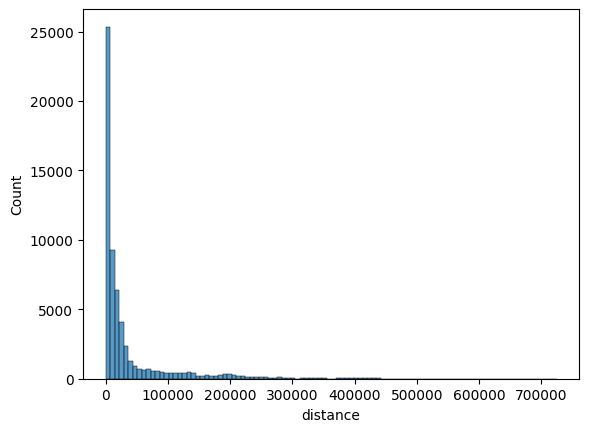

In [19]:
# see distribution of distance
sns.histplot(df_repeated_stats.query("distance > 0")['distance'], bins=100)

In [20]:
# see properties with distance between 0 and 50
(
    df_repeated_stats
    .query("distance > 0 & distance <= 50")
    .sort_values('distance', ascending=True)
    .head(5)
    )

,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance
property_id,,,,,,
14003191410195500,0.007350,0.0,0.0,13333.333333,4.0,1.340683
14008211110257600,0.007350,0.0,4.0,24666.666667,3.0,6.474017
11004212810235400,0.009961,0.0,0.0,0.000000,2.0,0.009961
14013212311204700,0.010075,0.0,0.0,2666.666667,3.0,0.276741
14013221411291600,0.010390,0.0,5.0,45000.000000,2.0,9.510390


In [21]:
# see properties with distance between 0 and 50
(
    df_repeated_stats
    .query("distance > 100 & distance <= 110")
    .sort_values('distance', ascending=True)
    .head(5)
    )

,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance
property_id,,,,,,
19014191710138200,100.010325,0.0,4.000000,41000.000000,2.0,108.110325
22005203010145100,100.023616,2.5,14.000000,118666.666667,4.0,128.390283
25003202410200500,100.215691,0.0,7.000000,76000.000000,2.0,114.815691
14006191112473500,100.252792,0.0,26.000000,202000.000000,2.0,146.452792
14013202211063400,100.393853,0.0,26.666667,278666.666667,3.0,154.927186


In [22]:
# see deciles of distance
df_repeated_stats['distance'].quantile(np.linspace(0, 1, 11))

0.0         0.000000
0.1        13.700491
0.2        36.068450
0.3      1123.941253
0.4      5922.317178
0.5     10269.505394
0.6     15635.985840
0.7     23204.066675
0.8     40411.131277
0.9    116464.188681
1.0    724491.882669
Name: distance, dtype: float64

In [23]:
# see property 23003220310419100
(
    gdf_repeated_property_id
    .query("property_id == '14013202211063400'")
    .sort_values('valuation_date')
    )

,valor_fisico_construccion,property_id,fecha_avaluo,neighborhood,id_clase_inmueble,id_tipo_inmueble,conservacion,elevador,niveles,cve_ref_proximidad_urbana,cve_nivel_equipamiento_urbano,valor_mercado,price,nivel,unidades_rentables,edad_anios,precio_m2,vida_util_remanente,cve_clasificacion_zona,cve_vigilancia,regimen_propiedad,tipo_vialidad,nivel_infraestructura,table_names-4,cuenta_predial,id_uv,id_municipio,id_entidad_f,clave_controlador,clave_valuador,id_otorgante,cp,recamaras,banos,medio_banos,estacionamiento,superficie_terreno,superficie_construida,superficie_accesoria,saleable_area,land_price_per_sqm,geometry,num_id_avaluo
866615,1042940.0,14013202211063400,2020-06-24,PEDREGAL DEL RIO,4,2,6.0,2.0,2,3,4,1681284,1681000,3,1,0,12707,70,4,NaN,PRIVADA INDIVIDUAL,NaN,NaN,ava_2020.csv,NaN,14013,016,22,1101542,1538625,30001,76803,3,2,1,2,123,132,0,132,3149.82,POINT (-99.96171 20.44308),3
866616,1042940.0,14013202211063400,2020-06-24,PEDREGAL DEL RIO,4,2,6.0,2.0,2,3,4,1681284,1681000,3,1,0,12707,70,4,NaN,PRIVADA INDIVIDUAL,NaN,NaN,ava_2020.csv,NaN,14013,016,22,1101542,1538625,30001,76803,3,2,1,2,123,132,0,132,3149.82,POINT (-99.96181 20.44339),3
995311,787355.0,14013202211063400,2020-06-24,PEDREGAL DEL RIO,4,3,6.0,2.0,2,3,4,1263387,1263000,3,S/D,0,13634,70,4,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2020.csv,NaN,14013,016,22,1101542,1538625,30001,76833,3,1,1,2,112,92,0,92,3191.00,POINT (-99.96081 20.44403),3


In [24]:
# see property 14003191410195500
(
    gdf_repeated_property_id
    .query("property_id == '14003191410195500'")
    .sort_values('valuation_date')
    )

,valor_fisico_construccion,property_id,fecha_avaluo,neighborhood,id_clase_inmueble,id_tipo_inmueble,conservacion,elevador,niveles,cve_ref_proximidad_urbana,cve_nivel_equipamiento_urbano,valor_mercado,price,nivel,unidades_rentables,edad_anios,precio_m2,vida_util_remanente,cve_clasificacion_zona,cve_vigilancia,regimen_propiedad,tipo_vialidad,nivel_infraestructura,table_names-4,cuenta_predial,id_uv,id_municipio,id_entidad_f,clave_controlador,clave_valuador,id_otorgante,cp,recamaras,banos,medio_banos,estacionamiento,superficie_terreno,superficie_construida,superficie_accesoria,saleable_area,land_price_per_sqm,geometry,num_id_avaluo
541995,254620.94,14003191410195500,2019-12-23,FRACCIONAMIENTO LOMA REAL ETAPA 2,3,4,6.0,2.0,1,4,3,415287,415000,5,S/D,0,8154,60,3,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2019.csv,NaN,14003,101,14,305839,305847,30001,45410,2,1,0,1,51,50,0,50,2353.72,POINT (-103.19035 20.66143),4
563066,254620.94,14003191410195500,2019-12-23,FRACCIONAMIENTO LOMA REAL ETAPA 2,3,4,6.0,2.0,1,4,3,434626,435000,4,S/D,0,8547,60,3,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2019.csv,NaN,14003,101,14,305839,305847,30001,45410,2,1,0,1,51,50,0,50,2651.48,POINT (-103.19035 20.66143),4
610982,254620.94,14003191410195500,2019-12-23,FRACCIONAMIENTO LOMA REAL ETAPA 2,3,4,6.0,2.0,1,4,3,434626,435000,4,S/D,0,8547,60,3,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2019.csv,NaN,14003,101,14,305839,305847,30001,45410,2,1,0,1,51,50,0,50,2651.48,POINT (-103.19035 20.66143),4
803324,254620.94,14003191410195500,2019-12-23,FRACCIONAMIENTO LOMA REAL ETAPA 2,3,4,6.0,2.0,1,4,3,415287,415000,5,S/D,0,8154,60,3,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2019.csv,NaN,14003,101,14,305839,305847,30001,45410,2,1,0,1,51,50,0,50,2353.72,POINT (-103.19035 20.66143),4


^^^
1. seems that the properties with the most repeated geocoords are practically the same, however some values are not the same
2. maybe stay with the oldest one in the cases is the same point
3. for properties with differences, maybe don't take all the points but a sample of 2-3 points

### Generate Flag of same property

heuristics

1. if distance is 0, then same property and stay with one
2. if distance is less than 100m and superficie_vendible_diff is less than 10m and valor_concluido_diff is less than 25K then same property and stay with one
3. for the rest, take a sample of num_duplicates // 2 points

#### Flagging

In [60]:
# flag duplicates
df_repeated_stats = (
    df_repeated_stats
    .assign(
        flag_duplicate_total_dist=lambda x: x['total_distance'].le(10),
        flag_time=lambda x: (
            x['distance'].le(100)
            & x['valor_concluido_diff'].div(1e+4).le(2.5)
            & x['superficie_vendible_diff'].le(10)
            & x['time_diff'].gt(0)
        ),
        flag_heuristic=lambda x: (
            x['distance'].le(100)
            & x['valor_concluido_diff'].div(1e+4).le(2.5)
            & x['superficie_vendible_diff'].le(10)
            & x['time_diff'].le(0)
        ),
        has_flag=lambda x: x['flag_duplicate_total_dist'] | x['flag_time'] | x['flag_heuristic']
    )
    .reset_index()
    .query("has_flag")
)
df_repeated_stats

,index,property_id,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance,flag_duplicate_total_dist,flag_time,flag_heuristic,has_flag
0,3,11001191110011800,48.035244,4.0,0.0,0.0,3.0,52.035244,False,True,False,True
1,5,11001191110012000,92.047278,0.0,0.0,0.0,4.0,92.047278,False,False,True,True
2,60,11003191910070500,70.963867,0.0,0.0,8000.0,2.0,71.763867,False,False,True,True
3,65,11003192310069700,0.000000,0.0,6.0,0.0,2.0,6.000000,True,False,True,True
4,71,11003192510065900,0.000000,0.0,2.0,32000.0,2.0,5.200000,True,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...
12625,62238,9083191110456280,0.000000,0.0,0.0,0.0,4.0,0.000000,True,False,True,True
12626,62239,9086212810326830,0.000000,0.0,0.0,0.0,8.0,0.000000,True,False,True,True
12627,62240,9086212810326840,0.000000,0.0,0.0,0.0,8.0,0.000000,True,False,True,True
12628,62241,9086212810326850,0.000000,0.0,0.0,0.0,8.0,0.000000,True,False,True,True


In [61]:
# flag columns to int
df_repeated_stats[df_repeated_stats.filter(like='flag').columns] = df_repeated_stats.filter(like='flag').astype(int)
df_repeated_stats.head()

,index,property_id,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance,flag_duplicate_total_dist,flag_time,flag_heuristic,has_flag
0,3,11001191110011800,48.035244,4.0,0.0,0.0,3.0,52.035244,0,1,0,1
1,5,11001191110012000,92.047278,0.0,0.0,0.0,4.0,92.047278,0,0,1,1
2,60,11003191910070500,70.963867,0.0,0.0,8000.0,2.0,71.763867,0,0,1,1
3,65,11003192310069700,0.000000,0.0,6.0,0.0,2.0,6.000000,1,0,1,1
4,71,11003192510065900,0.000000,0.0,2.0,32000.0,2.0,5.200000,1,0,0,1


In [70]:
# see some flag_time
(
    df_repeated_stats
    .query("flag_time.eq(1)")
    .sample(5)
    )

,index,property_id,distance,time_diff,superficie_vendible_diff,valor_concluido_diff,num_duplicates,total_distance,flag_duplicate_total_dist,flag_time,flag_heuristic,has_flag
10711,48475,23003232010450600,78.212999,1.0,1.0,0.0,2.0,80.212999,0,1,0,1
3380,18297,14011203210644200,13.507236,1.0,0.0,15000.0,2.0,16.007236,0,1,0,1
10897,50414,25003220910248800,0.000000,1.0,0.0,0.0,2.0,1.000000,1,1,0,1
8766,36925,19013201910107800,19.433851,2.0,0.0,0.0,2.0,21.433851,0,1,0,1
11703,56296,26005221010194500,28.205855,1.0,0.0,0.0,4.0,29.205855,0,1,0,1


In [66]:
# look at 14006212213181500
(
    gdf_repeated_property_id
    .query("property_id == '14006212213181500'")
    .sort_values('valuation_date')
    )

,valor_fisico_construccion,property_id,fecha_avaluo,neighborhood,id_clase_inmueble,id_tipo_inmueble,conservacion,elevador,niveles,cve_ref_proximidad_urbana,cve_nivel_equipamiento_urbano,valor_mercado,price,nivel,unidades_rentables,edad_anios,precio_m2,vida_util_remanente,cve_clasificacion_zona,cve_vigilancia,regimen_propiedad,tipo_vialidad,nivel_infraestructura,table_names-4,cuenta_predial,id_uv,id_municipio,id_entidad_f,clave_controlador,clave_valuador,id_otorgante,cp,recamaras,banos,medio_banos,estacionamiento,superficie_terreno,superficie_construida,superficie_accesoria,saleable_area,land_price_per_sqm,geometry,num_id_avaluo
195319,351890.0,14006212213181500,2021-09-27,VILLAS DEL REFUGIO COND C,3,4,6.0,2.0,1,3,3,822000,822000,5,S/D,0,16351,60,3,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2021.csv,NaN,14006,011,22,1500164,1005016,30002,76269,2,1,0,1,50,50,0,50,4950.0,POINT (-100.33351 20.65643),2
195322,349860.0,14006212213181500,2021-09-27,VILLAS DEL REFUGIO COND C,3,4,6.0,2.0,1,3,3,845000,845000,4,S/D,0,16906,60,3,NaN,PRIVADA COLECTIVA,NaN,NaN,ava_2021.csv,NaN,14006,011,22,1500164,1005016,30002,76269,2,1,0,1,50,49,0,49,4950.0,POINT (-100.33351 20.65650),2


#### Subset

In [71]:
# join with gdf_properties
gdf_properties2 = (
    gdf_properties
    .merge(df_repeated_stats, how='left', on='property_id')
    .assign(has_flag=lambda x: x['has_flag'].fillna(0))
)
print(f"Total properties: {gdf_properties2.shape[0]}")


Total properties: 1048575


In [72]:
# subset by flags and not flags
gdf_properties_not_flag = gdf_properties2.query("has_flag.eq(0)").copy()
gdf_properties_flag = gdf_properties2.query("has_flag.eq(1)").copy()
print(f"Flag properties: {gdf_properties_flag.shape[0]}")


Flag properties: 41920


In [73]:
# flag time
gdf_properties_flag_time = (
    gdf_properties_flag
    .query("flag_time.eq(1)")
    .sort_values('valuation_date', ascending=True)
    .groupby('property_id')
    # the way to handle duplicates of time
    .last()
    .reset_index()
)
print(f"Flag time properties before: {gdf_properties_flag.query('flag_time.eq(1)').shape[0]}")
print(f"Flag time properties after: {gdf_properties_flag_time.shape[0]}")


Flag time properties before: 1419
Flag time properties after: 416


In [83]:
# flag duplicate total dist or flag heuristic
gdf_properties_flag_not_time = (
    gdf_properties_flag
    .query("flag_time.eq(0)")  # the complement
    .assign(
        num_samples_repeated=lambda x: (
            x.groupby('property_id')['num_duplicates'].transform('max')
            .pipe(lambda x: x // 2)
            )
    )
    # sample the half of the duplicates
    .groupby('property_id')
    .apply(lambda x: x.sample(n=int(x['num_samples_repeated'].iloc[0])))
)
print(f"Flag not time properties before: {gdf_properties_flag.query('flag_time.eq(0)').shape[0]}")
print(f"Flag not time after: {gdf_properties_flag_not_time.shape[0]}")

Flag not time properties before: 40501
Flag not time after: 18002


/var/folders/42/2lkg1sf91wv7mjxw6klfcqtc0000gn/T/ipykernel_1079/2585055572.py:13: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(n=int(x['num_samples_repeated'].iloc[0])))


In [86]:
# join
gdf_properties2 = pd.concat([gdf_properties_not_flag, gdf_properties_flag_time, gdf_properties_flag_not_time], ignore_index=True)
print(f"Flag properties: {gdf_properties2.shape[0]}")

/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/array.py:1486: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


Flag properties: 1025073


In [87]:
# set gdf_properties = gdf_properties2
gdf_properties = gdf_properties2
del gdf_properties2

In [88]:
# see how many properties are
gdf_properties.shape[0]

1025073

In [93]:
# generate a new id
gdf_properties['property_id'] = [uuid.uuid4().hex for _ in range(gdf_properties.shape[0])]
gdf_properties['property_id']

0          14ac905851b04265b14c9b7adb3cd027
1          265fbcc03331434bb33c14dff8c7a3bd
2          349434fcdcaa41128124baf1deb14fa0
3          b8260ad924494232823ca2c1c96e535c
4          1a6106137e1f40348305bd6dc147ac03
                         ...               
1025068    0587e0ec62d74a74b9bc37ade33bc223
1025069    8ac3a174913a4e599be412a805458b4a
1025070    d83deac0a060485f86c62b65b4d6aa07
1025071    5f29e3bf38c449a3bd15009f72045ad8
1025072    63dd133c65b742df9eddbf88407b7a36
Name: property_id, Length: 1025073, dtype: object

In [94]:
# look for duplicates
gdf_properties['property_id'].nunique()

1025073

---
# Sandbox

In [ ]:
# value counts municipality_id
df_properties['municipality_id'].sort_values().unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 128, 129, 130, 131,
       132, 133, 134, 135, 136, 138, 139, 140, 141, 142, 143, 144, 145,
       146, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 160,
       161, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174,
       175, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 18

In [ ]:
# nan values municipality_id
df_properties['municipality_id'].isna().sum()

0

In [ ]:
gdf_properties

,price,id_entidad_f,id_municipio,geometry
0,721000,07,027,POINT (-92.94945 16.66506)
1,1842000,07,107,POINT (-93.00045 16.13782)
2,1394000,03,008,POINT (-109.58884 23.59371)
3,4305000,09,003,POINT (-99.15810 19.31087)
4,829000,21,051,POINT (-98.60966 18.51023)
...,...,...,...,...
1048570,922000,15,039,POINT (-98.85873 19.30929)
1048571,630000,15,020,POINT (-99.12189 19.64550)
1048572,730000,15,121,POINT (-99.21872 19.69844)
1048573,1020000,15,060,POINT (-99.27463 19.60902)


In [ ]:
gdf_mex_states

,geometry,cvegeo,cve_agee,nom_agee,nom_abrev,pob,pob_fem,pob_mas,viv
0,"MULTIPOLYGON (((-102.29739 22.45527, -102.2955...",01,01,Aguascalientes,Ags.,1425607,728924,696683,386671
1,"MULTIPOLYGON (((-114.11561 28.09639, -114.1152...",02,02,Baja California,BC,3769020,1868431,1900589,1149563
2,"MULTIPOLYGON (((-109.89451 22.87476, -109.8946...",03,03,Baja California Sur,BCS,798447,392568,405879,240660
3,"MULTIPOLYGON (((-91.95650 20.19700, -91.95636 ...",04,04,Campeche,Camp.,928363,471424,456939,260824
4,"MULTIPOLYGON (((-102.31549 29.88000, -102.3150...",05,05,Coahuila de Zaragoza,Coah.,3146771,1583102,1563669,901249
5,"MULTIPOLYGON (((-114.73734 18.37206, -114.7364...",06,06,Colima,Col.,731391,370769,360622,227050
6,"MULTIPOLYGON (((-91.99567 17.94259, -91.99296 ...",07,07,Chiapas,Chis.,5543828,2837881,2705947,1351630
7,"MULTIPOLYGON (((-108.13866 31.78375, -108.1361...",08,08,Chihuahua,Chih.,3741869,1888047,1853822,1146915
8,"MULTIPOLYGON (((-99.12215 19.59248, -99.12078 ...",09,09,Ciudad de México,CDMX,9209944,4805017,4404927,2757433
9,"MULTIPOLYGON (((-106.03486 26.83507, -106.0331...",10,10,Durango,Dgo.,1832650,927784,904866,493989


In [ ]:
gdf_mun

,geometry,cvegeo,cve_agee,cve_agem,nom_agem,cve_cab,pob,pob_fem,pob_mas,viv,nom_cab
0,"MULTIPOLYGON (((-92.19932 15.55231, -92.19931 ...",07036,07,036,La Grandeza,0001,7701,3936,3765,1538,NaN
1,"MULTIPOLYGON (((-92.51090 15.48201, -92.50380 ...",07032,07,032,Escuintla,0001,30896,15682,15214,7882,NaN
2,"MULTIPOLYGON (((-93.25070 17.54430, -93.24688 ...",07088,07,088,Sunuapa,0001,2308,1133,1175,561,NaN
3,"MULTIPOLYGON (((-93.05856 17.27962, -93.05812 ...",07067,07,067,Pantepec,0001,12266,6212,6054,2938,NaN
4,"MULTIPOLYGON (((-93.08646 16.69305, -93.08486 ...",07086,07,086,Suchiapa,0001,25627,12871,12756,6362,NaN
...,...,...,...,...,...,...,...,...,...,...,...
119,"MULTIPOLYGON (((-93.26314 16.58582, -93.25296 ...",07108,07,108,Villaflores,0001,109536,55728,53808,29277,NaN
120,"MULTIPOLYGON (((-92.23124 17.25477, -92.23033 ...",07109,07,109,Yajalón,0001,40285,20695,19590,8753,NaN
121,"MULTIPOLYGON (((-92.43050 17.12311, -92.42728 ...",07066,07,066,Pantelhó,0001,26391,13441,12950,4931,NaN
122,"MULTIPOLYGON (((-92.56706 15.34044, -92.56588 ...",07071,07,071,Villa Comaltitlán,0001,30297,14719,15578,7682,NaN


In [ ]:
def get_distance(x):
    d_matrix =  squareform(pdist(x, metric='euclidean'))
    print(d_matrix)
    upper_triangle = np.triu(d_matrix, k=1)
    avg_distance = upper_triangle.mean()
    return avg_distance

aux_df = (
     gdf_repeated_property_id
    .query("property_id == '11001190110011900'")
)

pdist(
    aux_df.to_crs('EPSG:6372')['geometry'].apply(lambda x: x.coords[0]).values.reshape(-1, 1),
    metric='euclidean'
    )

/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)


ValueError: Unsupported dtype object

In [ ]:
aux_df.to_crs('EPSG:6372')['geometry'].apply(lambda x: x.coords[0]).values.reshape(-1, 1)

/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)


array([[(2474292.2106925133, 1091031.664072714)],
       [(2474184.1446099347, 1091056.2011374081)],
       [(2468880.0705091585, 1106030.700600219)]], dtype=object)

In [ ]:
np.array(list(aux_df['geometry'].geometry.apply(lambda x: (x.x, x.y))))

/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)


array([[-102.2499231,   21.8356241],
       [-102.2509741,   21.8358451],
       [-102.302846 ,   21.971673 ]])

In [ ]:
# Example: Create a GeoDataFrame with some points
from shapely.geometry import Point

data = {'geometry': [Point(1, 2), Point(4, 6), Point(7, 8)]}
gdf = gpd.GeoDataFrame(data, crs="EPSG:4326")

coords = np.array(list(gdf.geometry.apply(lambda geom: (geom.x, geom.y))))

dist_matrix = squareform(pdist(coords, metric='euclidean'))

dist_matrix

/Users/ravj/opt/anaconda3/envs/dd3/lib/python3.10/site-packages/geopandas/geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)


array([[0.        , 5.        , 8.48528137],
       [5.        , 0.        , 3.60555128],
       [8.48528137, 3.60555128, 0.        ]])

In [ ]:
squareform(pdist(aux_df['valuation_date'].dt.day.values.reshape(-1, 1)))

array([[0., 0., 2.],
       [0., 0., 2.],
       [2., 2., 0.]])

In [ ]:
aux_df['valuation_date'].dt.day.values.reshape(-1, 1)

array([[23],
       [23],
       [25]], dtype=int32)